In [1]:
#import libraries
import pandas as pd #
import pytesseract #
print('pyt:',pytesseract.get_tesseract_version())
from PIL import Image #
import PIL
print('pillow:',PIL.__version__)
# import cv2
import numpy as np #
# import os.path
import urllib.request #urllib3
from skimage.filters import  threshold_sauvola #
from pytesseract import pytesseract
filecounter = 0
from skimage import data #
from skimage.data import page #
from skimage.filters import  threshold_sauvola #

pyt: 5.0.0-alpha.20200328
pillow: 7.1.2


In [2]:
links = pd.read_csv('links_indexing.csv')

In [3]:
links

,MN_year,FROM_LINK,TO_LINK,BK_year,FROM_PAGENO,TO_PAGENO
0,1850-51,http://link.nypl.org/YaM1vgXiR9ivhW3dG5ai-wv,http://link.nypl.org/N5yYkitXTRiiR9kdl3B73ww,NaN,NaN,NaN
1,1850-51,http://link.nypl.org/lbOn3RV_Q8ao5uDxg9PNiwk,http://link.nypl.org/yfFajz9RTomv_1F9gFzMRQ1,NaN,NaN,NaN
2,1850-51,http://link.nypl.org/EL4H9ZK_TXaBn8mnm9M_Ygx,http://link.nypl.org/KrTYtiqET4yAUGKFItnM7wQ,NaN,NaN,NaN
3,1850-51,http://link.nypl.org/v4z9ciN6QdaIT5y5fC-nggf,http://link.nypl.org/Of1EWKi1Sc-TLOQ9Y-5UaQw,NaN,NaN,NaN
4,1850-51,http://link.nypl.org/doVkWtZkReafMWmnTGplCg5,http://link.nypl.org/BZGOAF_tT8S84PMhhFLi-Qy,NaN,NaN,NaN


In [3]:
year_links = links.loc[links['MN_year'] == '1850-51'] #subset dataframe with only 1850-51 rows

In [5]:
#first set of links
 #getting all from links (from , to corresponds to the subset of links to be used from the scraped ones)
 #getting all to links
from_url =year_links.iloc[0]['FROM_LINK']
to_url = year_links.iloc[0]['TO_LINK']

In [6]:
#part 1
#getting urls
file = open('MN_scrapedlinks\MN_1850-51.txt','r')
Lines = file.read().splitlines()
# print(Lines)
subset_urls = []
flag = False
for item in Lines:
    if(item == from_url):
        flag = True
    if(flag == True):
        subset_urls.append(item)
    if(item == to_url):
        flag = False
        break


In [7]:
#running on first one
# from_ url = 'http://link.nypl.org/YaM1vgXiR9ivhW3dG5ai-wv' #-- start
image = Image.open(urllib.request.urlopen(from_url))

# cropping 
width, height = image.size   # Get dimensions
left = width/4
top =  height/5
right = 4 * width/5
bottom = 3.5 * height/5
cropped_example = image.crop((left, top, right, bottom))

#rotating
rotated = cropped_example.transpose(Image.ROTATE_270)

grayimage = rotated.convert('L')
f_image = np.asarray(grayimage)
t_sauvola = threshold_sauvola(f_image, window_size=23)
binary_image = f_image > t_sauvola
# print(type(binary_image))
#saving binary image as a tif (required for obtaining hocr format from tesseract)
new_im = Image.fromarray(binary_image)
# print(type(new_im))

In [8]:
new_im.show()

In [9]:
binary_image

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

In [10]:
new_im.save("saved.tif")
pytesseract.run_tesseract('saved.tif', 'output', lang=None, config="hocr", extension="hocr")

In [11]:
x = !hocr-detect-columns --mode json output.hocr

In [12]:
# print(x.n)

In [13]:
#save json file
filecounter += 1
if(filecounter < 10):
    with open('tess_output/MN_1850-51/page0{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
        f.write(x.n)

In [14]:
#running on second type page
# from_ url = 'http://link.nypl.org/YaM1vgXiR9ivhW3dG5ai-wv' #-- start
image = Image.open(urllib.request.urlopen(to_url))

# cropping 
width, height = image.size   # Get dimensions
left = width/4
top =  height/5
right = 4 * width/5
bottom = 3.5 * height/5
cropped_example = image.crop((left, top, right, bottom))

#rotating
rotated = cropped_example.transpose(Image.ROTATE_90)

#local thresholding


grayimage = rotated.convert('L')
f_image = np.asarray(grayimage)
t_sauvola = threshold_sauvola(f_image, window_size=23)
binary_image = f_image > t_sauvola
#saving binary image as a tif (required for obtaining hocr format from tesseract)
new_im = Image.fromarray(binary_image)
#create hocr file
new_im.save("saved.tif")
!tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1


Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295


In [15]:
x = !hocr-detect-columns --mode json hocr_output.hocr

In [16]:
#save json file
filecounter += 1
if(filecounter < 10):
    with open('tess_output/MN_1850-51/page0{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
        f.write(x.n)

In [17]:
#second set of links

from_url =year_links.iloc[1]['FROM_LINK']
to_url = year_links.iloc[1]['TO_LINK']

In [18]:
#part 1
#getting urls
file = open('MN_scrapedlinks\MN_1850-51.txt','r')
Lines = file.read().splitlines()
# print(Lines)
subset_urls = []
flag = False
for item in Lines:
#         print(item)
    if(item == from_url):
    #             print('found')
        flag = True
    if(flag == True):
        subset_urls.append(item)
    if(item == to_url):
#         subset_urls.append(item)
        flag = False
        break
# subset_urls

In [19]:
filecounter = 2
for i  in range(len(subset_urls)):
    if(i % 2 == 0):

        image = Image.open(urllib.request.urlopen(subset_urls[i]))
        # display(image)

        # cropping 
        width, height = image.size   # Get dimensions
        left = width/4
        top =  height/5
        right = 4 * width/5
        bottom = 3.5 * height/5
        cropped_example = image.crop((left, top, right, bottom))
        # display(cropped_example)

        #rotating
        rotated = cropped_example.transpose(Image.ROTATE_90)
#         display(rotated)

        #local thresholding

        grayimage = rotated.convert('L')
        f_image = np.asarray(grayimage)
        t_sauvola = threshold_sauvola(f_image, window_size=23)
        binary_image = f_image > t_sauvola
        #saving binary image as a tif (required for obtaining hocr format from tesseract)
        new_im = Image.fromarray(binary_image)
        #create hocr file
        new_im.save("saved.tif")
        !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
        x = !hocr-detect-columns --mode json hocr_output.hocr
#         new_im.show()
        #save json file
        filecounter += 1
        if(filecounter < 10):
            with open('tess_output/MN_1850-51/page0{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
        else:
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
            
    else:
        image = Image.open(urllib.request.urlopen(subset_urls[i]))
        # display(image)

        # cropping 
        width, height = image.size   # Get dimensions
        left = width/5
        top =  height/5
        right = 4 * width/5
        bottom = 3.5 * height/5
        cropped_example = image.crop((left, top, right, bottom))
        # display(cropped_example)

        #rotating
        rotated = cropped_example.transpose(Image.ROTATE_270)
#         display(rotated)

        #local thresholding

        grayimage = rotated.convert('L')
        f_image = np.asarray(grayimage)
        t_sauvola = threshold_sauvola(f_image, window_size=23)
        binary_image = f_image > t_sauvola
        #saving binary image as a tif (required for obtaining hocr format from tesseract)
        new_im = Image.fromarray(binary_image)
        #create hocr file
        new_im.save("saved.tif")
        !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
        x = !hocr-detect-columns --mode json hocr_output.hocr
#         new_im.show()
        #save json file
        filecounter += 1
        if(filecounter < 10):
            with open('tess_output/MN_1850-51/page0{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
        else:
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)



Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 301
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 302
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Error in boxClipToRectangle: box outside recta

In [20]:
image = Image.open(urllib.request.urlopen(subset_urls[1]))
        # display(image)

# cropping 
width, height = image.size   # Get dimensions
left = width/5
top =  height/5
right = 4 * width/5
bottom = 3.5 * height/5
cropped_example = image.crop((left, top, right, bottom))
# display(cropped_example)
cropped_example.show()
#rotating
rotated = cropped_example.transpose(Image.ROTATE_270)
#         display(rotated)

#local thresholding

grayimage = rotated.convert('L')
f_image = np.asarray(grayimage)
t_sauvola = threshold_sauvola(f_image, window_size=23)
binary_image = f_image > t_sauvola
#saving binary image as a tif (required for obtaining hocr format from tesseract)
new_im = Image.fromarray(binary_image)
new_im.save("saved.tif")
!tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
x = !hocr-detect-columns --mode json hocr_output.hocr
# new_im.show()
#         save json file
# filecounter += 1
# if(filecounter < 10):
with open('tess_output/MN_1850-51/page04.json'.format(filecounter), 'w',encoding="utf-8") as f:
    f.write(x.n)

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296


In [21]:
#second set of links

from_url =year_links.iloc[2]['FROM_LINK']
to_url = year_links.iloc[2]['TO_LINK']

In [22]:
#getting urls
file = open('MN_scrapedlinks\MN_1850-51.txt','r')
Lines = file.read().splitlines()
# print(Lines)
subset_urls = []
flag = False
for item in Lines:
#         print(item)
    if(item == from_url):
    #             print('found')
        flag = True
    if(flag == True):
        subset_urls.append(item)
    if(item == to_url):
#         subset_urls.append(item)
        flag = False
        break
# subset_urls

In [26]:
subset_urls

['http://link.nypl.org/EL4H9ZK_TXaBn8mnm9M_Ygx',
 'http://link.nypl.org/oe5oflflSnCWa_kSc0Tk8Ax',
 'http://link.nypl.org/PnyzY-wrSfCCB-xbtwBepg9',
 'http://link.nypl.org/bJq1dVCOSaS7-LyRaHzgXgu',
 'http://link.nypl.org/-YM_DP17TC6yMJado1DYSwZ',
 'http://link.nypl.org/8hoVnCunRCmi4ysvDYBpsQM',
 'http://link.nypl.org/r0IOtZRDSkuqdrho6JOLZgE',
 'http://link.nypl.org/mKS6iKMcTKS1jYEbOhoUtwl',
 'http://link.nypl.org/6XfMf0sgTdO4mhPkxX6weQn',
 'http://link.nypl.org/RICstigRQ7WBdnIzQw7VtAT',
 'http://link.nypl.org/HsbBncM-TMCaR_sU-TtlGwT',
 'http://link.nypl.org/1GekJmsoQJa4hmchlG_oSQY',
 'http://link.nypl.org/7EszIeujSbyQv2RWOje6DAT',
 'http://link.nypl.org/lkaDe-7cSbWf-JbAyTHslAA',
 'http://link.nypl.org/ayUnOEONlgXWy-37a',
 'http://link.nypl.org/HIWydTOwQ8CW3RExNI_ciQv',
 'http://link.nypl.org/NmLlT8-xQJGXNFNwH1kl0QT',
 'http://link.nypl.org/kLhAEzrpSzeppVAm2J0XewJ',
 'http://link.nypl.org/yKsFvo_TQU-Jh5EHCufBtQk',
 'http://link.nypl.org/5mP0WTA6RfWRvYWKvoKiUAe',
 'http://link.nypl.org/nPW

In [23]:
# #testing
# image = Image.open(urllib.request.urlopen(subset_urls[0]))
# # display(image)

# # cropping 
# width, height = image.size   # Get dimensions
# left = width/4
# top =  height/5
# right = 4 * width/5
# bottom = 3.5 * height/5
# cropped_example = image.crop((left, top, right, bottom))
# # display(cropped_example)

# #rotating
# rotated = cropped_example.transpose(Image.ROTATE_90)
# display(rotated)


In [27]:
filecounter = 16
for i  in range(len(subset_urls)):
    try:
        if(i % 2 == 0):
            image = Image.open(urllib.request.urlopen(subset_urls[i]))
            # display(image)

            # cropping 
            width, height = image.size   # Get dimensions
            left = width/4
            top =  height/5
            right = 4 * width/5
            bottom = 3.5 * height/5
            cropped_example = image.crop((left, top, right, bottom))

            #rotating
            rotated = cropped_example.transpose(Image.ROTATE_90)

            #local thresholding

            grayimage = rotated.convert('L')
            f_image = np.asarray(grayimage)
            t_sauvola = threshold_sauvola(f_image, window_size=23)
            binary_image = f_image > t_sauvola
            #saving binary image as a tif (required for obtaining hocr format from tesseract)
            new_im = Image.fromarray(binary_image)
            #create hocr file
            new_im.save("saved.tif")
            !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
            x = !hocr-detect-columns --mode json hocr_output.hocr
            #save json file
            filecounter += 1
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
        else:
            image = Image.open(urllib.request.urlopen(subset_urls[i]))

            # cropping 
            width, height = image.size   # Get dimensions
            left = width/4
            top =  height/5
            right = 4 * width/5
            bottom = 3.5 * height/5
            cropped_example = image.crop((left, top, right, bottom))

            #rotating
            rotated = cropped_example.transpose(Image.ROTATE_270)

            #local thresholding

            grayimage = rotated.convert('L')
            f_image = np.asarray(grayimage)
            t_sauvola = threshold_sauvola(f_image, window_size=23)
            binary_image = f_image > t_sauvola
            #saving binary image as a tif (required for obtaining hocr format from tesseract)
            new_im = Image.fromarray(binary_image)
            #create hocr file
            new_im.save("saved.tif")
            !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
            x = !hocr-detect-columns --mode json hocr_output.hocr
            #save json file
            filecounter += 1
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
    except:
        print(subset_urls[i])



Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.

http://link.nypl.org/ayUnOEONlgXWy-37a


Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 288
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 285
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 287
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 287
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 288
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 286
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 288
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Error in boxClipToRectangle: box outside recta

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 287
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Error in boxClipToRectangle: box outside rectangle
Error i

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica


Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estim

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 287
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estim

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294


In [28]:
filecounter

311

In [4]:
#next set of links

from_url =year_links.iloc[3]['FROM_LINK']
to_url = year_links.iloc[3]['TO_LINK']

In [5]:
#getting urls
file = open('MN_scrapedlinks\MN_1850-51.txt','r')
Lines = file.read().splitlines()
subset_urls = []
flag = False
for item in Lines:
    if(item == from_url):
        flag = True
    if(flag == True):
        subset_urls.append(item)
    if(item == to_url):
        flag = False
        break


In [6]:
subset_urls

['http://link.nypl.org/v4z9ciN6QdaIT5y5fC-nggf',
 'http://link.nypl.org/BDcKqYC2QEKkpHZu2vZWZQV',
 'http://link.nypl.org/yy_3ES42TbOI0HRB3GbKnAZ',
 'http://link.nypl.org/5qnqJwMJTwCJxUuuaBB3Mgp',
 'http://link.nypl.org/_Q7AfVRrQw2XdlIf7uHt7g8',
 'http://link.nypl.org/Of1EWKi1Sc-TLOQ9Y-5UaQw']

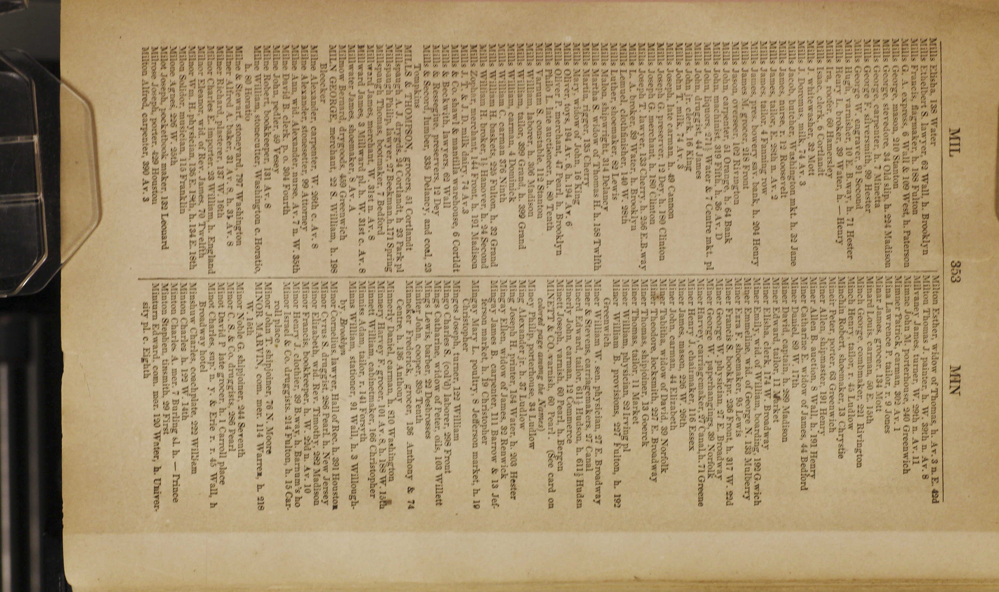

In [11]:
#testing
image = Image.open(urllib.request.urlopen(subset_urls[0]))
# display(image)

# cropping 
width, height = image.size   # Get dimensions
left = width/5
top =  height/6
right = 4 * width/5
bottom = 3.5 * height/5
cropped_example = image.crop((left, top, right, bottom))
display(cropped_example)

#rotating
# rotated = cropped_example.transpose(Image.ROTATE_270)
# display(rotated)


In [12]:
filecounter = 311
for i  in range(len(subset_urls)):
    try:
        if(i % 2 == 0):
            image = Image.open(urllib.request.urlopen(subset_urls[i]))
            # display(image)

            # cropping 
            width, height = image.size   # Get dimensions
            left = width/5
            top =  height/6
            right = 4 * width/5
            bottom = 3.5 * height/5
            cropped_example = image.crop((left, top, right, bottom))

            #rotating
            rotated = cropped_example.transpose(Image.ROTATE_90)

            #local thresholding

            grayimage = rotated.convert('L')
            f_image = np.asarray(grayimage)
            t_sauvola = threshold_sauvola(f_image, window_size=23)
            binary_image = f_image > t_sauvola
            #saving binary image as a tif (required for obtaining hocr format from tesseract)
            new_im = Image.fromarray(binary_image)
            #create hocr file
            new_im.save("saved.tif")
            !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
            x = !hocr-detect-columns --mode json hocr_output.hocr
            #save json file
            filecounter += 1
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
        else:
            image = Image.open(urllib.request.urlopen(subset_urls[i]))

            # cropping 
            width, height = image.size   # Get dimensions
            left = width/5
            top =  height/6
            right = 4 * width/5
            bottom = 3.5 * height/5
            cropped_example = image.crop((left, top, right, bottom))

            #rotating
            rotated = cropped_example.transpose(Image.ROTATE_270)

            #local thresholding

            grayimage = rotated.convert('L')
            f_image = np.asarray(grayimage)
            t_sauvola = threshold_sauvola(f_image, window_size=23)
            binary_image = f_image > t_sauvola
            #saving binary image as a tif (required for obtaining hocr format from tesseract)
            new_im = Image.fromarray(binary_image)
            #create hocr file
            new_im.save("saved.tif")
            !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
            x = !hocr-detect-columns --mode json hocr_output.hocr
            #save json file
            filecounter += 1
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
    except:
        print(subset_urls[i])



Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 209
Detected 2292 diacritics
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 299
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 288
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 299


In [14]:
filecounter

317

In [15]:
#next set of links

from_url =year_links.iloc[4]['FROM_LINK']
to_url = year_links.iloc[4]['TO_LINK']

In [16]:
#getting urls
file = open('MN_scrapedlinks\MN_1850-51.txt','r')
Lines = file.read().splitlines()
subset_urls = []
flag = False
for item in Lines:
    if(item == from_url):
        flag = True
    if(flag == True):
        subset_urls.append(item)
    if(item == to_url):
        flag = False
        break


In [17]:
subset_urls

['http://link.nypl.org/doVkWtZkReafMWmnTGplCg5',
 'http://link.nypl.org/0k6L8EsuSxaKXKDzZ2OLtAX',
 'http://link.nypl.org/jyygbViTQC6OR2L58NpUug8',
 'http://link.nypl.org/GcMxVK-ZSCakDg70SCGvXQn',
 'http://link.nypl.org/o6KZ8Fs1TKKRxAvkWbx-EgP',
 'http://link.nypl.org/LqpnUl5RS52bV_HAE7NOkgZ',
 'http://link.nypl.org/z4aD_vZgTCSni89jvEYswgU',
 'http://link.nypl.org/DPSkFxyJQt6NWQGnl_857g_',
 'http://link.nypl.org/vzupzFdRRmqG9Q60Muv1ygj',
 'http://link.nypl.org/-2Blb6kQS2GuQJfLcehMMw-',
 'http://link.nypl.org/wtTRJO_QRz6ZHNiYOn_lzwq',
 'http://link.nypl.org/NnG1eRJfQX-ilQ7b39JA4gB',
 'http://link.nypl.org/jehr3C3QR4exIei91GJ9ZAV',
 'http://link.nypl.org/M2juVJNuSOORXPgzvs2reQJ',
 'http://link.nypl.org/bOO7mLB8R5ufBLg-HGGFYgu',
 'http://link.nypl.org/zvm2M5N4SFaD1e3MyfuyAge',
 'http://link.nypl.org/C0bSnrZLRJekMlIBI7NhaQ1',
 'http://link.nypl.org/_qtUfgR5SGWJNB-RR-rL6QV',
 'http://link.nypl.org/4Dq3DvbjQpmCafuI2b-DiAw',
 'http://link.nypl.org/AMSiWZimT4W3F2phPKJRTAS',
 'http://link.nypl.o

In [18]:
len(subset_urls)

202

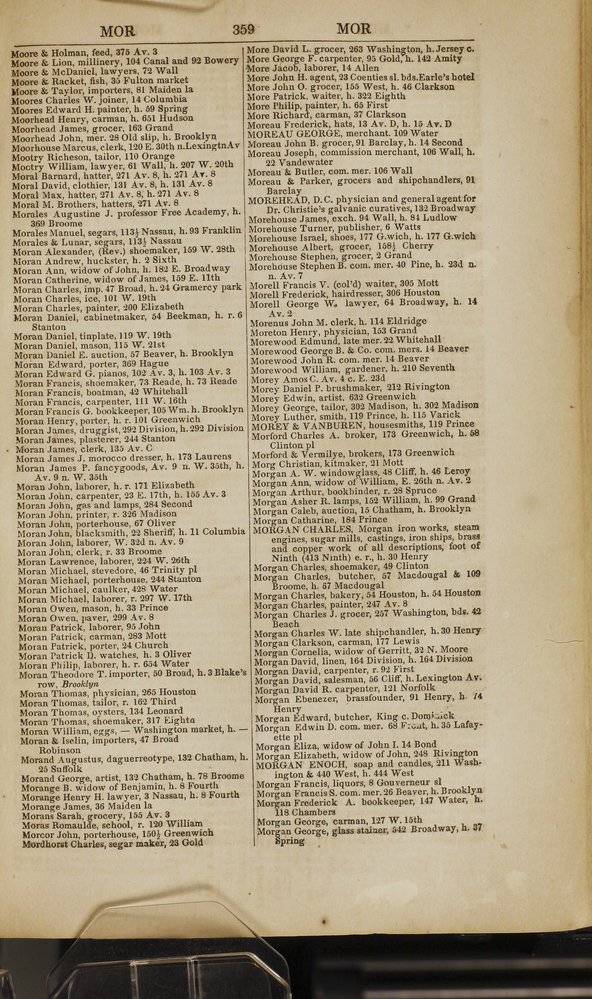

In [48]:
#testing
image = Image.open(urllib.request.urlopen(subset_urls[0]))
# display(image)

# cropping 
width, height = image.size   # Get dimensions
left = width/5 ###change from 5 to 6 for 1 (odds)
top =  height/6 ### change from 5 to 6 for both
right = 4 * width/5
bottom = 3.5 * height/5
cropped_example = image.crop((left, top, right, bottom))
# display(cropped_example)

# rotating
rotated = cropped_example.transpose(Image.ROTATE_90)
display(rotated)


In [19]:
filecounter = 317
for i  in range(len(subset_urls)):
    try:
        if(i % 2 == 0):
            image = Image.open(urllib.request.urlopen(subset_urls[i]))
            # display(image)

            # cropping 
            width, height = image.size   # Get dimensions
            left = width/5
            top =  height/6
            right = 4 * width/5
            bottom = 3.5 * height/5
            cropped_example = image.crop((left, top, right, bottom))

            #rotating
            rotated = cropped_example.transpose(Image.ROTATE_90)

            #local thresholding

            grayimage = rotated.convert('L')
            f_image = np.asarray(grayimage)
            t_sauvola = threshold_sauvola(f_image, window_size=23)
            binary_image = f_image > t_sauvola
            #saving binary image as a tif (required for obtaining hocr format from tesseract)
            new_im = Image.fromarray(binary_image)
            #create hocr file
            new_im.save("saved.tif")
            !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
            x = !hocr-detect-columns --mode json hocr_output.hocr
            #save json file
            filecounter += 1
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
        else:
            image = Image.open(urllib.request.urlopen(subset_urls[i]))

            # cropping 
            width, height = image.size   # Get dimensions
            left = width/5
            top =  height/6
            right = 4 * width/5
            bottom = 3.5 * height/5
            cropped_example = image.crop((left, top, right, bottom))

            #rotating
            rotated = cropped_example.transpose(Image.ROTATE_270)

            #local thresholding

            grayimage = rotated.convert('L')
            f_image = np.asarray(grayimage)
            t_sauvola = threshold_sauvola(f_image, window_size=23)
            binary_image = f_image > t_sauvola
            #saving binary image as a tif (required for obtaining hocr format from tesseract)
            new_im = Image.fromarray(binary_image)
            #create hocr file
            new_im.save("saved.tif")
            !tesseract "saved.tif" "hocr_output" -c tessedit_create_hocr=1
            x = !hocr-detect-columns --mode json hocr_output.hocr
            #save json file
            filecounter += 1
            with open('tess_output/MN_1850-51/page{}.json'.format(filecounter), 'w',encoding="utf-8") as f:
                f.write(x.n)
    except:
        print(subset_urls[i])



Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 299
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 288
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 wit

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 287
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 285
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 287
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 292
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 284
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 wit

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 288
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 293
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 289
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 303
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 295
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 297
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 291
Error in boxClipToRectangle: box outside rectangle
Error in pixScanForForeground: invalid box
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 wit

Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 296
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 290
Tesseract Open Source OCR Engine v5.0.0-alpha.20200328 with Leptonica
Page 1
Estimating resolution as 294


In [20]:
filecounter

519